In [43]:
import scanpy as sc
import scvelo as scv
import cellrank as cr
import pandas as pd
import numpy as np
import loompy
import harmonypy as hm

In [49]:
# Define loom file paths
loom1 = "/Users/S208205/Library/CloudStorage/Box-Box/S.Zhang_Lab/UTSW_DATA/R02_EA/MetTag_BC_OVA/DATA/Looms/R02_EA_L1_LARRYreseq.loom"
loom2 = "/Users/S208205/Library/CloudStorage/Box-Box/S.Zhang_Lab/UTSW_DATA/R02_EA/MetTag_BC_OVA/DATA/Looms/R02_EA_L2_LARRYreseq.loom"

# Load loom files
adata1 = sc.read_loom(loom1)
adata1.var_names_make_unique()
adata1.obs_names = [
    f"Om_{name.split(':')[-1].replace('x', '-1')}" 
    for name in adata1.obs_names
]

adata2 = sc.read_loom(loom2)
adata2.var_names_make_unique()
adata2.obs_names = [
    f"Asc_{name.split(':')[-1].replace('x', '-1')}" 
    for name in adata2.obs_names
]

/opt/anaconda3/envs/ISS/lib/python3.12/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/opt/anaconda3/envs/ISS/lib/python3.12/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [50]:
adata1.obs_names

Index(['Om_AAAGGTAGTAGGTCAG-1', 'Om_AAACCCATCTCGAACA-1',
       'Om_AAAGAACCAATGCTCA-1', 'Om_AAAGGGCTCTGTAACG-1',
       'Om_AAAGTGAGTCATAAAG-1', 'Om_AAAGTGAAGCTTAAGA-1',
       'Om_AAAGTGAAGTTACGTC-1', 'Om_AAAGGATCAACAGCTT-1',
       'Om_AAAGTGACAAATTGGA-1', 'Om_AAACGCTAGAGTTGAT-1',
       ...
       'Om_TTTGTTGCATACTGTG-1', 'Om_TTTGGTTAGTTGTAGA-1',
       'Om_TTTGGTTTCCGACGGT-1', 'Om_TTTGATCGTACTGGGA-1',
       'Om_TTTGATCGTCATCCCT-1', 'Om_TTTGGTTAGCATGAAT-1',
       'Om_TTTGTTGGTGATATAG-1', 'Om_TTTGATCCACATGTTG-1',
       'Om_TTTGGAGCACTTCATT-1', 'Om_TTTGGAGCACGGCTAC-1'],
      dtype='object', length=11959)

In [51]:
adata2.obs_names

Index(['Asc_AAAGTGATCCTTCAGC-1', 'Asc_AAAGAACGTTGGCTAT-1',
       'Asc_AAAGGTAAGCCAGACA-1', 'Asc_AACCAACCAGAGGAAA-1',
       'Asc_AACACACAGGGAGGGT-1', 'Asc_AAAGGTAAGAAGATCT-1',
       'Asc_AAAGGTACAGATCACT-1', 'Asc_AACAAAGAGAGGTCAC-1',
       'Asc_AAAGGGCGTTGGGTAG-1', 'Asc_AACACACAGAAGCGGG-1',
       ...
       'Asc_TTTGGTTGTGGAATGC-1', 'Asc_TTTGACTAGGTGAGCT-1',
       'Asc_TTTGATCGTGGTCTCG-1', 'Asc_TTTAGTCGTACTTCCC-1',
       'Asc_TTTACTGTCGGTAACT-1', 'Asc_TTTATGCCATGCCGAC-1',
       'Asc_TTTGGTTTCGTTGTTT-1', 'Asc_TTTCAGTTCTTACACT-1',
       'Asc_TTTCATGCATTGTCGA-1', 'Asc_TTTCATGAGAACAGGA-1'],
      dtype='object', length=5277)

In [52]:
#pre-processing
def preprocess_adata(adata):
    # Normalize (total-count normalize) the data
    sc.pp.normalize_total(adata, target_sum=1e4)
    # Logarithmize the data
    sc.pp.log1p(adata)
    # Identify highly variable genes
    sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
    # Subset to highly variable genes
    adata = adata[:, adata.var.highly_variable]
    # Optional: Regress out effects of total counts per cell and the percentage of mitochondrial genes expressed
    # sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])
    # Scale the data to unit variance and zero mean
    sc.pp.scale(adata, max_value=10)


# Apply preprocessing to each dataset
preprocess_adata(adata1)
preprocess_adata(adata2)

/opt/anaconda3/envs/ISS/lib/python3.12/site-packages/scanpy/preprocessing/_scale.py:309: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/opt/anaconda3/envs/ISS/lib/python3.12/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)
/opt/anaconda3/envs/ISS/lib/python3.12/site-packages/scanpy/preprocessing/_scale.py:309: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/opt/anaconda3/envs/ISS/lib/python3.12/functools.py:909: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


In [53]:
print(adata1.obs.head())

Empty DataFrame
Columns: []
Index: [Om_AAAGGTAGTAGGTCAG-1, Om_AAACCCATCTCGAACA-1, Om_AAAGAACCAATGCTCA-1, Om_AAAGGGCTCTGTAACG-1, Om_AAAGTGAGTCATAAAG-1]


In [54]:
print(adata2.obs.head())

Empty DataFrame
Columns: []
Index: [Asc_AAAGTGATCCTTCAGC-1, Asc_AAAGAACGTTGGCTAT-1, Asc_AAAGGTAAGCCAGACA-1, Asc_AACCAACCAGAGGAAA-1, Asc_AACACACAGGGAGGGT-1]


In [55]:
print(adata1.var_names[:5])   # First 5 gene names
print(adata1.obs_names[:5])   # First 5 cell barcodes

Index(['Xkr4', 'Gm37381', 'Rp1', 'Sox17', 'Gm37323'], dtype='object', name='Gene')
Index(['Om_AAAGGTAGTAGGTCAG-1', 'Om_AAACCCATCTCGAACA-1',
       'Om_AAAGAACCAATGCTCA-1', 'Om_AAAGGGCTCTGTAACG-1',
       'Om_AAAGTGAGTCATAAAG-1'],
      dtype='object')


In [56]:
print(adata2.var_names[:5])   # First 5 gene names
print(adata2.obs_names[:5])   # First 5 cell barcodes

Index(['Xkr4', 'Gm37381', 'Rp1', 'Sox17', 'Gm37323'], dtype='object', name='Gene')
Index(['Asc_AAAGTGATCCTTCAGC-1', 'Asc_AAAGAACGTTGGCTAT-1',
       'Asc_AAAGGTAAGCCAGACA-1', 'Asc_AACCAACCAGAGGAAA-1',
       'Asc_AACACACAGGGAGGGT-1'],
      dtype='object')


In [57]:
adata1.obs_names

Index(['Om_AAAGGTAGTAGGTCAG-1', 'Om_AAACCCATCTCGAACA-1',
       'Om_AAAGAACCAATGCTCA-1', 'Om_AAAGGGCTCTGTAACG-1',
       'Om_AAAGTGAGTCATAAAG-1', 'Om_AAAGTGAAGCTTAAGA-1',
       'Om_AAAGTGAAGTTACGTC-1', 'Om_AAAGGATCAACAGCTT-1',
       'Om_AAAGTGACAAATTGGA-1', 'Om_AAACGCTAGAGTTGAT-1',
       ...
       'Om_TTTGTTGCATACTGTG-1', 'Om_TTTGGTTAGTTGTAGA-1',
       'Om_TTTGGTTTCCGACGGT-1', 'Om_TTTGATCGTACTGGGA-1',
       'Om_TTTGATCGTCATCCCT-1', 'Om_TTTGGTTAGCATGAAT-1',
       'Om_TTTGTTGGTGATATAG-1', 'Om_TTTGATCCACATGTTG-1',
       'Om_TTTGGAGCACTTCATT-1', 'Om_TTTGGAGCACGGCTAC-1'],
      dtype='object', length=11959)

In [58]:
adata2.obs_names

Index(['Asc_AAAGTGATCCTTCAGC-1', 'Asc_AAAGAACGTTGGCTAT-1',
       'Asc_AAAGGTAAGCCAGACA-1', 'Asc_AACCAACCAGAGGAAA-1',
       'Asc_AACACACAGGGAGGGT-1', 'Asc_AAAGGTAAGAAGATCT-1',
       'Asc_AAAGGTACAGATCACT-1', 'Asc_AACAAAGAGAGGTCAC-1',
       'Asc_AAAGGGCGTTGGGTAG-1', 'Asc_AACACACAGAAGCGGG-1',
       ...
       'Asc_TTTGGTTGTGGAATGC-1', 'Asc_TTTGACTAGGTGAGCT-1',
       'Asc_TTTGATCGTGGTCTCG-1', 'Asc_TTTAGTCGTACTTCCC-1',
       'Asc_TTTACTGTCGGTAACT-1', 'Asc_TTTATGCCATGCCGAC-1',
       'Asc_TTTGGTTTCGTTGTTT-1', 'Asc_TTTCAGTTCTTACACT-1',
       'Asc_TTTCATGCATTGTCGA-1', 'Asc_TTTCATGAGAACAGGA-1'],
      dtype='object', length=5277)

In [59]:
# Combine preprocessed datasets
adata_combined = sc.AnnData.concatenate(adata1, adata2, batch_key='Lanes', index_unique=None)
print(adata_combined.shape)

(17236, 31062)


In [60]:
# Check the first few cell names
print(adata_combined.obs_names[:5])
print(adata_combined.obs_names[10000:100010])

Index(['Om_AAAGGTAGTAGGTCAG-1', 'Om_AAACCCATCTCGAACA-1',
       'Om_AAAGAACCAATGCTCA-1', 'Om_AAAGGGCTCTGTAACG-1',
       'Om_AAAGTGAGTCATAAAG-1'],
      dtype='object')
Index(['Om_TCGTCCACAAGATGGC-1', 'Om_TCGTAGAAGAAGTATC-1',
       'Om_TCGTGCTAGAATTGTG-1', 'Om_TCGTGCTGTTGCGGCT-1',
       'Om_TCGTGCTAGGTCACAG-1', 'Om_TCTACATAGCGTTAGG-1',
       'Om_TCGTAGAGTACAACGG-1', 'Om_TCGTGGGTCCAGTACA-1',
       'Om_TCGGTCTCATAACTCG-1', 'Om_TCGTCCAGTGCGGCTT-1',
       ...
       'Asc_TTTGGTTGTGGAATGC-1', 'Asc_TTTGACTAGGTGAGCT-1',
       'Asc_TTTGATCGTGGTCTCG-1', 'Asc_TTTAGTCGTACTTCCC-1',
       'Asc_TTTACTGTCGGTAACT-1', 'Asc_TTTATGCCATGCCGAC-1',
       'Asc_TTTGGTTTCGTTGTTT-1', 'Asc_TTTCAGTTCTTACACT-1',
       'Asc_TTTCATGCATTGTCGA-1', 'Asc_TTTCATGAGAACAGGA-1'],
      dtype='object', length=7236)


In [61]:
# Check the batch assignment, can see matches cell numbers in CellRanger web summary
print(adata_combined.obs['Lanes'].value_counts())

Lanes
0    11959
1     5277
Name: count, dtype: int64


In [62]:
# If you want to check the total number of unique cell IDs
print(f"Total number of unique cell IDs: {adata_combined.obs_names.nunique()}")

Total number of unique cell IDs: 17236


In [63]:
# Perform PCA
sc.tl.pca(adata_combined, svd_solver='arpack')

In [64]:
# ===== Run Harmony integration  =======
sc.external.pp.harmony_integrate(adata_combined, key='Lanes')

2025-06-28 17:53:58,733 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-06-28 17:54:01,878 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-06-28 17:54:01,909 - harmonypy - INFO - Iteration 1 of 10
2025-06-28 17:54:03,297 - harmonypy - INFO - Iteration 2 of 10
2025-06-28 17:54:04,833 - harmonypy - INFO - Iteration 3 of 10
2025-06-28 17:54:06,077 - harmonypy - INFO - Iteration 4 of 10
2025-06-28 17:54:07,323 - harmonypy - INFO - Iteration 5 of 10
2025-06-28 17:54:08,169 - harmonypy - INFO - Iteration 6 of 10
2025-06-28 17:54:09,399 - harmonypy - INFO - Iteration 7 of 10
2025-06-28 17:54:10,048 - harmonypy - INFO - Converged after 7 iterations


In [65]:
# save integrated obj
adata_combined.write('adata_EA02_combined_integrated.h5ad')

In [66]:
import os
import cellrank as cr    
import matplotlib.pyplot as plt

In [67]:
#check working directory
print(os.getcwd())

/Users/S208205/Library/CloudStorage/Box-Box/S.Zhang_Lab/UTSW_DATA/R02_EA/MetTag_BC_OVA/DATA/Looms


In [68]:
adata = sc.read_h5ad('adata_EA02_combined_integrated.h5ad')

In [69]:
adata

AnnData object with n_obs × n_vars = 17236 × 31062
    obs: 'Lanes'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1'
    uns: 'pca'
    obsm: 'X_pca', 'X_pca_harmony'
    varm: 'PCs'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

## Read in Seurat objects converted to .h5ad to subset out cells of interest. 
See conversion guide here: https://mojaveazure.github.io/seurat-disk/articles/convert-anndata.html
### in R, need to convert from V5 version to older verson of assay first. 
library(SeuratDisk)
object.i <- Mets
object.i[["RNA"]] <- CreateAssayObject(counts = object.i[["RNA"]]$counts) #Convert Assay v5 to Assay
SeuratDisk::SaveH5Seurat(object.i, filename = "/Users/S208205/Library/CloudStorage/Box-Box/S.Zhang_Lab/UTSW_DATA/R02_EA/MetTag_BC_OVA/DATA/Looms/Mets.h5Seurat", overwrite = TRUE)
SeuratDisk::Convert("/Users/S208205/Library/CloudStorage/Box-Box/S.Zhang_Lab/UTSW_DATA/R02_EA/MetTag_BC_OVA/DATA/Looms/Mets.h5Seurat", dest = "h5ad", overwrite = TRUE)


In [70]:
adata_subset = sc.read_h5ad("Mets.h5ad")

In [71]:
print(adata_subset.obs_names[:5])

Index(['Om_AAACCCAAGCGTCTCG-1', 'Om_AAACGAATCCACCCTA-1',
       'Om_AAACGCTAGTAAACGT-1', 'Om_AAACGCTCAGCCGTCA-1',
       'Om_AAACGCTGTGGCTAGA-1'],
      dtype='object')


In [91]:
adata_subset

AnnData object with n_obs × n_vars = 2402 × 31062
    obs: 'om_orig.ident.x', 'om_nCount_RNA', 'om_nFeature_RNA', 'om_nCount_CITE', 'om_nFeature_CITE', 'om_nCount_HTO', 'om_nFeature_HTO', 'om_percent.mt', 'om_RNA_ratio', 'om_HTO_ratio', 'om_HTO_maxID', 'om_HTO_secondID', 'om_HTO_margin', 'om_HTO_classification', 'om_HTO_classification.global', 'om_hash.ID', 'om_orig.ident.y', 'om_nCount_LARRY', 'om_nFeature_LARRY', 'om_nCount_Lib_ID', 'om_nFeature_Lib_ID', 'om_LARRY_ratio', 'om_Lib_ID_ratio', 'om_LibID_first_bc', 'om_LibID_second_bc', 'om_LibID_bc_classification', 'om_LARRY_first_bc', 'om_LARRY_second_bc', 'om_LARRY_bc_classification', 'om_LARRY_status', 'om_Lib_ID_status', 'om_HTO_group', 'Asc_orig.ident.x', 'Asc_nCount_RNA', 'Asc_nFeature_RNA', 'Asc_nCount_CITE', 'Asc_nFeature_CITE', 'Asc_nCount_HTO', 'Asc_nFeature_HTO', 'Asc_percent.mt', 'Asc_RNA_ratio', 'Asc_HTO_ratio', 'Asc_HTO_maxID', 'Asc_HTO_secondID', 'Asc_HTO_margin', 'Asc_HTO_classification', 'Asc_HTO_classification.global',

In [72]:
print(adata_subset.obs_names[:5])
print(adata.obs_names[:5])

Index(['Om_AAACCCAAGCGTCTCG-1', 'Om_AAACGAATCCACCCTA-1',
       'Om_AAACGCTAGTAAACGT-1', 'Om_AAACGCTCAGCCGTCA-1',
       'Om_AAACGCTGTGGCTAGA-1'],
      dtype='object')
Index(['Om_AAAGGTAGTAGGTCAG-1', 'Om_AAACCCATCTCGAACA-1',
       'Om_AAAGAACCAATGCTCA-1', 'Om_AAAGGGCTCTGTAACG-1',
       'Om_AAAGTGAGTCATAAAG-1'],
      dtype='object')


In [73]:
# Identify common cells by cell names
common_cells = adata_subset.obs_names[adata_subset.obs_names.isin(adata.obs_names)]
print(f"Number of matching cells: {len(common_cells)}")  # Ensure it matches the expected number

Number of matching cells: 2402


In [75]:
# Ensure the conversion to list is necessary if you're directly subsetting
common_cell_names_list = list(common_cells)

In [94]:
# Subset the original AnnData object to include only the common cells
adata_Mets_subset = adata[common_cell_names_list].copy()

In [95]:
adata_Mets_subset.var_names_make_unique()

In [96]:
# this is the subset loom of Mets tumor cells for Cellrank2 analysis next
adata_Mets_subset

AnnData object with n_obs × n_vars = 2402 × 31062
    obs: 'Lanes'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1'
    uns: 'pca'
    obsm: 'X_pca', 'X_pca_harmony'
    varm: 'PCs'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

In [97]:
# Confirm that the obs_names match and are in the same order:
assert all(adata_Mets_subset.obs_names == adata_subset.obs_names), \
       "Cell orders differ! Reindex before copying."

In [98]:
# Copy the UMAP embedding over:
adata_Mets_subset.obsm['X_umap'] = adata_subset.obsm['X_umap'].copy()

In [99]:
# Join the two obs DataFrames on their index (the cell names)
adata_Mets_subset.obs = adata_Mets_subset.obs.join(
    adata_subset.obs, how="left"
)

In [100]:
adata_Mets_subset

AnnData object with n_obs × n_vars = 2402 × 31062
    obs: 'Lanes', 'om_orig.ident.x', 'om_nCount_RNA', 'om_nFeature_RNA', 'om_nCount_CITE', 'om_nFeature_CITE', 'om_nCount_HTO', 'om_nFeature_HTO', 'om_percent.mt', 'om_RNA_ratio', 'om_HTO_ratio', 'om_HTO_maxID', 'om_HTO_secondID', 'om_HTO_margin', 'om_HTO_classification', 'om_HTO_classification.global', 'om_hash.ID', 'om_orig.ident.y', 'om_nCount_LARRY', 'om_nFeature_LARRY', 'om_nCount_Lib_ID', 'om_nFeature_Lib_ID', 'om_LARRY_ratio', 'om_Lib_ID_ratio', 'om_LibID_first_bc', 'om_LibID_second_bc', 'om_LibID_bc_classification', 'om_LARRY_first_bc', 'om_LARRY_second_bc', 'om_LARRY_bc_classification', 'om_LARRY_status', 'om_Lib_ID_status', 'om_HTO_group', 'Asc_orig.ident.x', 'Asc_nCount_RNA', 'Asc_nFeature_RNA', 'Asc_nCount_CITE', 'Asc_nFeature_CITE', 'Asc_nCount_HTO', 'Asc_nFeature_HTO', 'Asc_percent.mt', 'Asc_RNA_ratio', 'Asc_HTO_ratio', 'Asc_HTO_maxID', 'Asc_HTO_secondID', 'Asc_HTO_margin', 'Asc_HTO_classification', 'Asc_HTO_classification

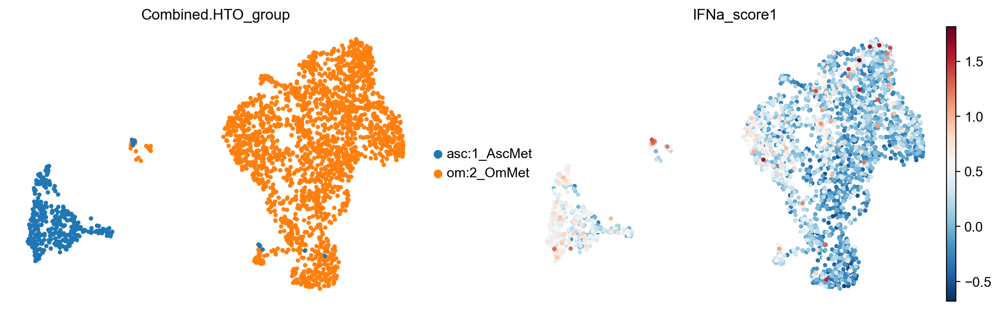

In [117]:
sc.pl.embedding(adata_Mets_subset, basis='X_umap', color=['Combined.HTO_group','IFNa_score1'])

# Cellrank2 analysis

In [118]:
import scvelo as scv
import cellrank as cr
import matplotlib as mpl
from cellrank.kernels import RealTimeKernel

sc.settings.set_figure_params(frameon=False, dpi=100)
cr.settings.verbosity = 2

mpl.rcParams['savefig.format']    = 'pdf'
mpl.rcParams['savefig.bbox']      = 'tight'
mpl.rcParams['savefig.dpi']       = 600     # for high‐res
mpl.rcParams['savefig.transparent']= False

# For reproducible plots
scv.settings.set_figure_params('scvelo')

In [119]:
print("Layers:", adata_Mets_subset.layers.keys())
print("Embeddings:", adata_Mets_subset.obsm.keys())

Layers: KeysView(Layers with keys: ambiguous, matrix, spliced, unspliced, Ms, Mu, velocity, variance_velocity)
Embeddings: KeysView(AxisArrays with keys: X_pca, X_pca_harmony, X_umap)


In [123]:
adata.layers["spliced"] = adata.X
adata.layers["unspliced"] = adata.X

In [124]:
scv.pp.moments(
    adata_Mets_subset,
    n_pcs=30,                      # number of PCs to use
    n_neighbors=30,                # size of neighbourhood
    use_highly_variable=False,     # apply to all genes by default
)

computing moments based on connectivities
    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [122]:
import warnings

warnings.simplefilter("ignore", category=UserWarning)

##  Estimate moments

## Compute the CytoTRACE score

In [126]:
from cellrank.kernels import CytoTRACEKernel

ctk = CytoTRACEKernel(adata_Mets_subset).compute_cytotrace()

Computing CytoTRACE score with `31062` genes
Adding `adata.obs['ct_score']`
       `adata.obs['ct_pseudotime']`
       `adata.obs['ct_num_exp_genes']`
       `adata.var['ct_gene_corr']`
       `adata.var['ct_correlates']`
       `adata.uns['ct_params']`
    Finish (0:00:00)


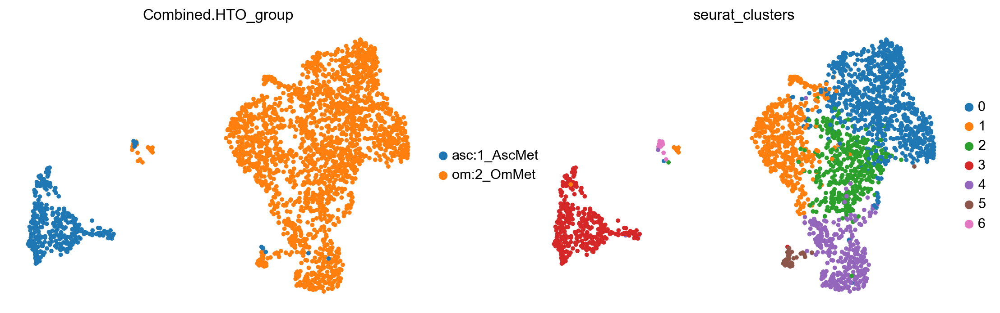

In [129]:
sc.pl.embedding(
    adata_Mets_subset,
    color=["Combined.HTO_group", "seurat_clusters"],
    basis="X_umap",
    color_map="gnuplot2",
)

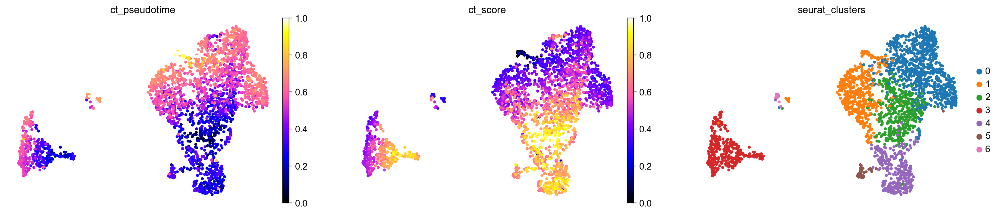

In [131]:
sc.pl.embedding(
    adata_Mets_subset,
    color=["ct_pseudotime", "ct_score","seurat_clusters"],
    basis="X_umap",
    color_map="gnuplot2",
)

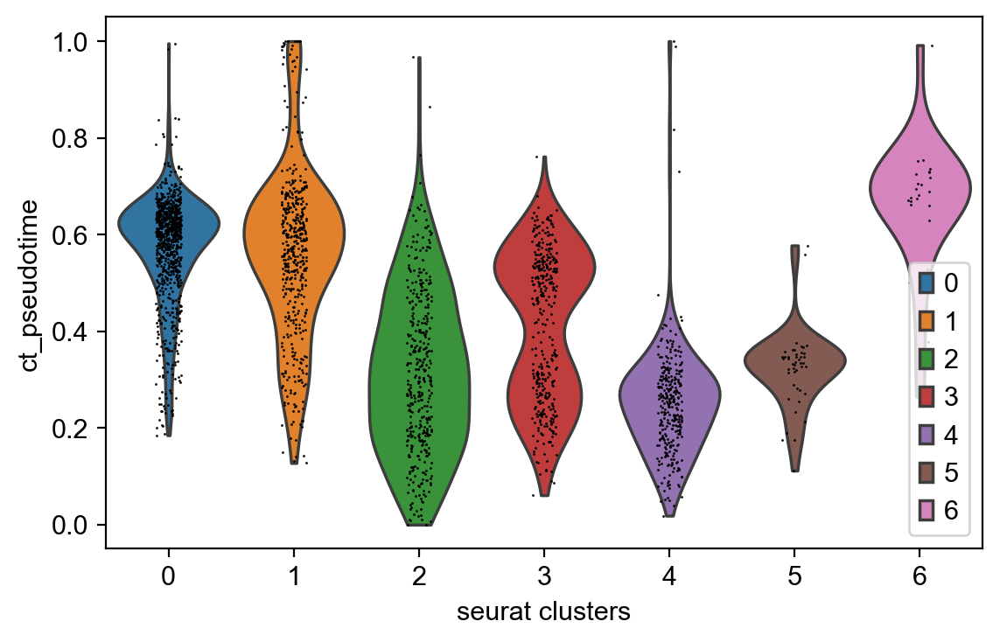

In [135]:
sc.pl.violin(adata_Mets_subset, keys=["ct_pseudotime"], groupby="seurat_clusters")

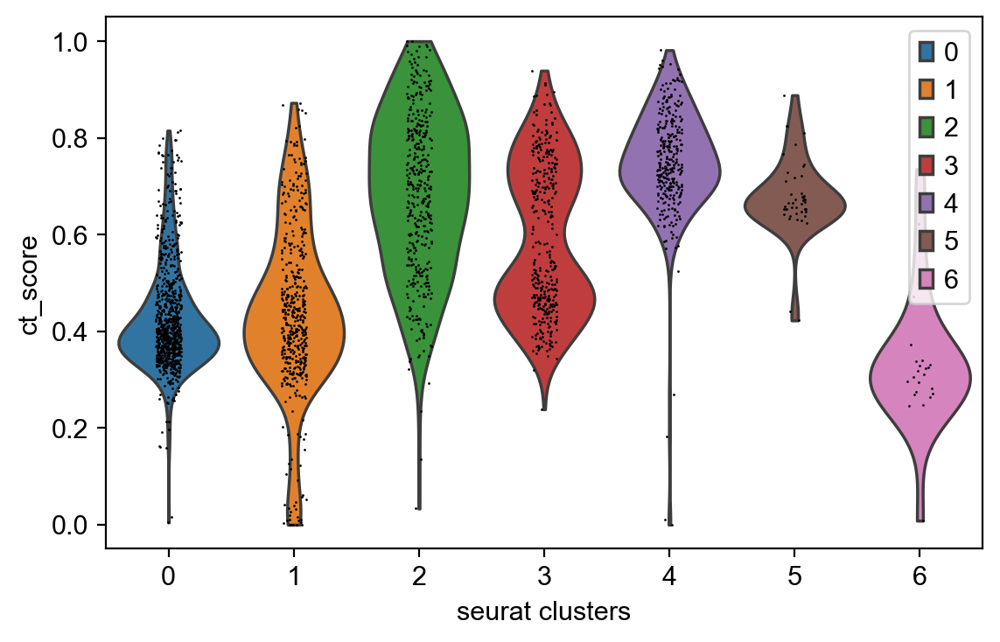

In [136]:
sc.pl.violin(adata_Mets_subset, keys=["ct_score"], groupby="seurat_clusters")

## Compute & visualize a transition matrix

In [137]:
ctk.compute_transition_matrix(threshold_scheme="soft", nu=0.5)

Computing transition matrix based on pseudotime


  0%|          | 0/2402 [00:00<?, ?cell/s]

    Finish (0:00:01)


CytoTRACEKernel[n=2402, dnorm=False, scheme='soft', b=10.0, nu=0.5]

Projecting transition matrix onto `umap`
Adding `adata.obsm['T_fwd_umap']`
    Finish (0:00:00)


/opt/anaconda3/envs/ISS/lib/python3.12/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/opt/anaconda3/envs/ISS/lib/python3.12/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/opt/anaconda3/envs/ISS/lib/python3.12/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/opt/anaconda3/envs/ISS/lib/python3.12/site-packages/scvelo/plotting/utils.py:68: Deprecati

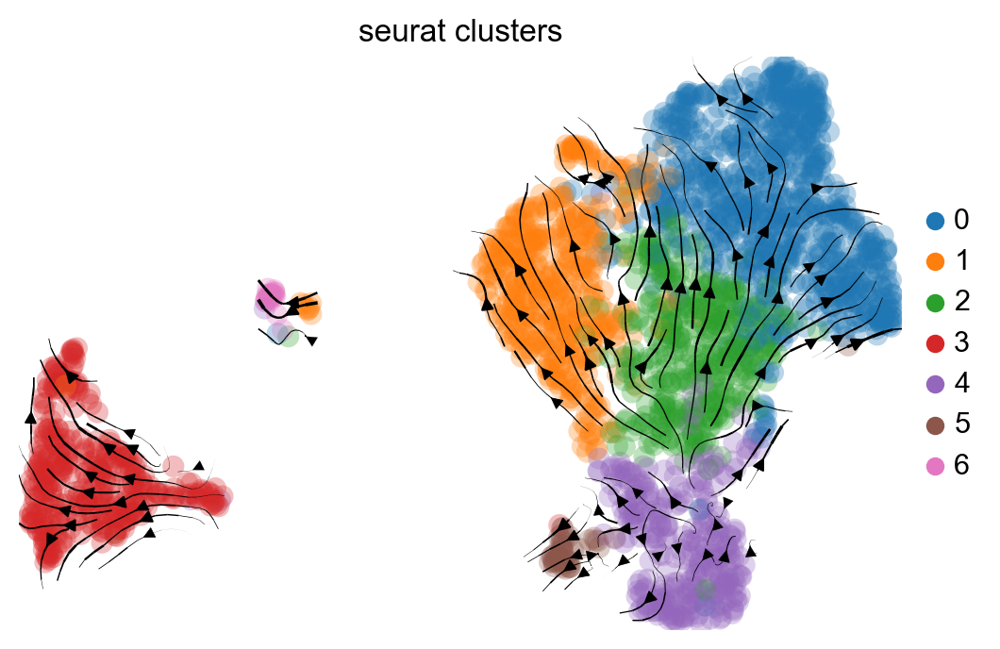

In [138]:
ctk.plot_projection(basis="X_umap", color="seurat_clusters", legend_loc="right")

## CellRank Meets RNA Velocity

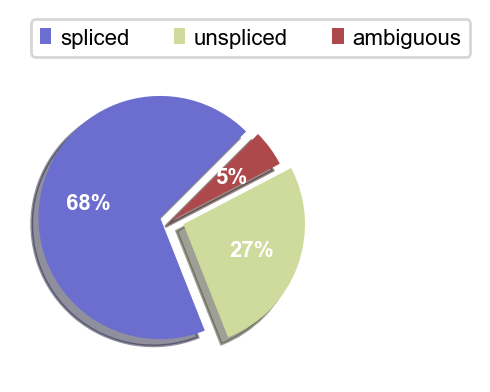

AnnData object with n_obs × n_vars = 2402 × 31062
    obs: 'Lanes', 'om_orig.ident.x', 'om_nCount_RNA', 'om_nFeature_RNA', 'om_nCount_CITE', 'om_nFeature_CITE', 'om_nCount_HTO', 'om_nFeature_HTO', 'om_percent.mt', 'om_RNA_ratio', 'om_HTO_ratio', 'om_HTO_maxID', 'om_HTO_secondID', 'om_HTO_margin', 'om_HTO_classification', 'om_HTO_classification.global', 'om_hash.ID', 'om_orig.ident.y', 'om_nCount_LARRY', 'om_nFeature_LARRY', 'om_nCount_Lib_ID', 'om_nFeature_Lib_ID', 'om_LARRY_ratio', 'om_Lib_ID_ratio', 'om_LibID_first_bc', 'om_LibID_second_bc', 'om_LibID_bc_classification', 'om_LARRY_first_bc', 'om_LARRY_second_bc', 'om_LARRY_bc_classification', 'om_LARRY_status', 'om_Lib_ID_status', 'om_HTO_group', 'Asc_orig.ident.x', 'Asc_nCount_RNA', 'Asc_nFeature_RNA', 'Asc_nCount_CITE', 'Asc_nFeature_CITE', 'Asc_nCount_HTO', 'Asc_nFeature_HTO', 'Asc_percent.mt', 'Asc_RNA_ratio', 'Asc_HTO_ratio', 'Asc_HTO_maxID', 'Asc_HTO_secondID', 'Asc_HTO_margin', 'Asc_HTO_classification', 'Asc_HTO_classification

In [143]:
scv.pl.proportions(adata_Mets_subset)
adata_Mets_subset

In [144]:
scv.tl.recover_dynamics(adata_Mets_subset, n_jobs=8)

recovering dynamics (using 8/8 cores)


  0%|          | 0/3309 [00:00<?, ?gene/s]

    finished (0:02:47) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)


In [145]:
scv.tl.velocity(adata_Mets_subset, mode="dynamical")

computing velocities
    finished (0:00:05) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


### Combine RNA velocity with expression similarity in high dimensions

In [146]:
vk = cr.kernels.VelocityKernel(adata_Mets_subset)

In [147]:
vk.compute_transition_matrix()

Computing transition matrix using `'deterministic'` model


  0%|          | 0/2402 [00:00<?, ?cell/s]

Using `softmax_scale=11.2374`


  0%|          | 0/2402 [00:00<?, ?cell/s]

    Finish (0:00:06)


VelocityKernel[n=2402, model='deterministic', similarity='correlation', softmax_scale=11.237]

In [150]:
ck = cr.kernels.ConnectivityKernel(adata_Mets_subset)
ck.compute_transition_matrix()

combined_kernel = 0.8 * vk + 0.2 * ck

Computing transition matrix based on `adata.obsp['connectivities']`
    Finish (0:00:00)


In [151]:
print(combined_kernel)

(0.8 * VelocityKernel[n=2402] + 0.2 * ConnectivityKernel[n=2402])


## Visualize the transition matrix

Using precomputed projection `adata.obsm['T_fwd_umap']`


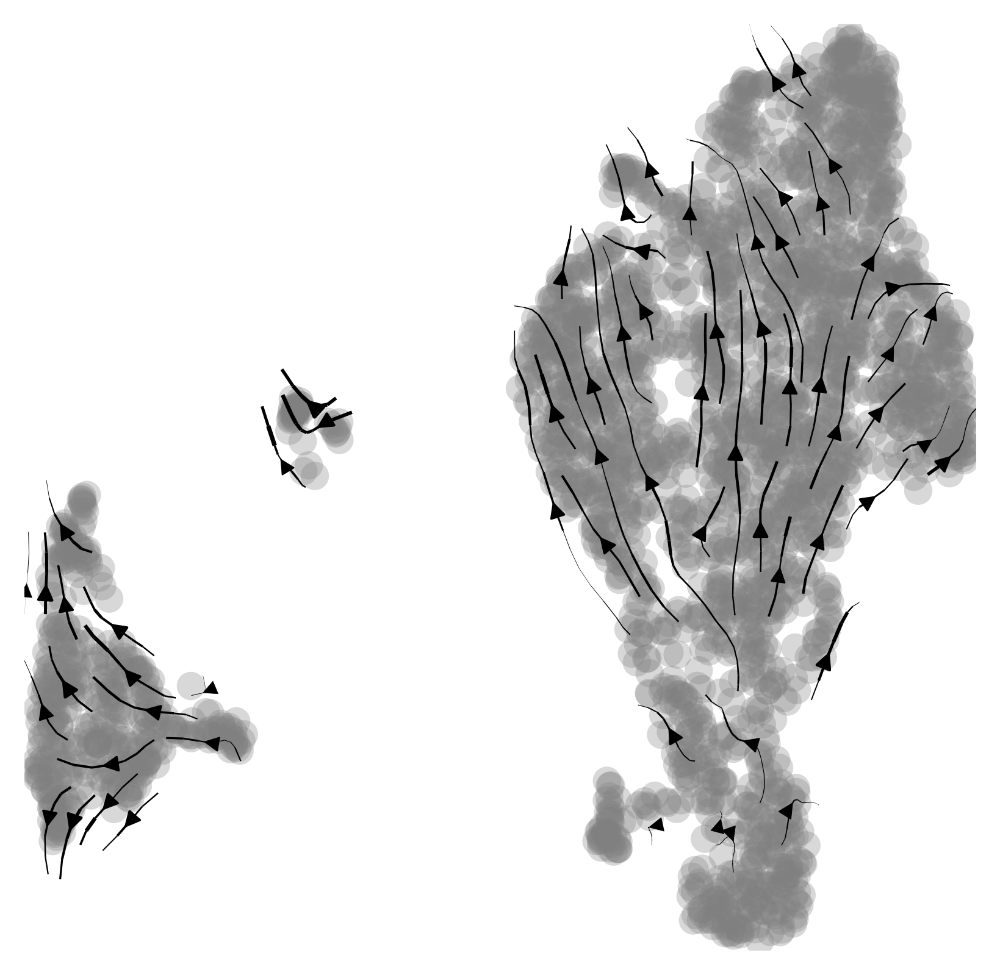

In [174]:
vk.plot_projection(
    basis="X_umap",         # which embedding in adata.obsm to project onto
    key_added=None,         # if you give a string, the coordinates are saved to adata.obsm[key_added]
    recompute=False,        # if True, forces CellRank to redraw even if a projection already exists
    stream=True,            # True: smooth streamlines; False: arrows on a grid
    connectivities=None,    # override the kernel’s own .connectivities matrix if you want
    # … then any downstream plotting options below …
    density=1.5,            # (only for stream=True) controls grid‐resolution of the streamlines
    arrow_size=1.0,         # scaling of arrowheads
    arrow_style="-|>",      # Matplotlib arrow style
    min_mass=0.5,           # threshold for how “strong” a flow must be to get drawn
    integration_direction="forward",  # or "backward" or "both"
    legend_loc="on data",   # position of legend
    figsize=(5, 5),         # size of the figure
    dpi=200                 # output resolution (useful if you plan to save to PDF)
)

Simulating `100` random walks of maximum length `30`


  0%|          | 0/100 [00:00<?, ?sim/s]

    Finish (0:00:00)
Plotting random walks


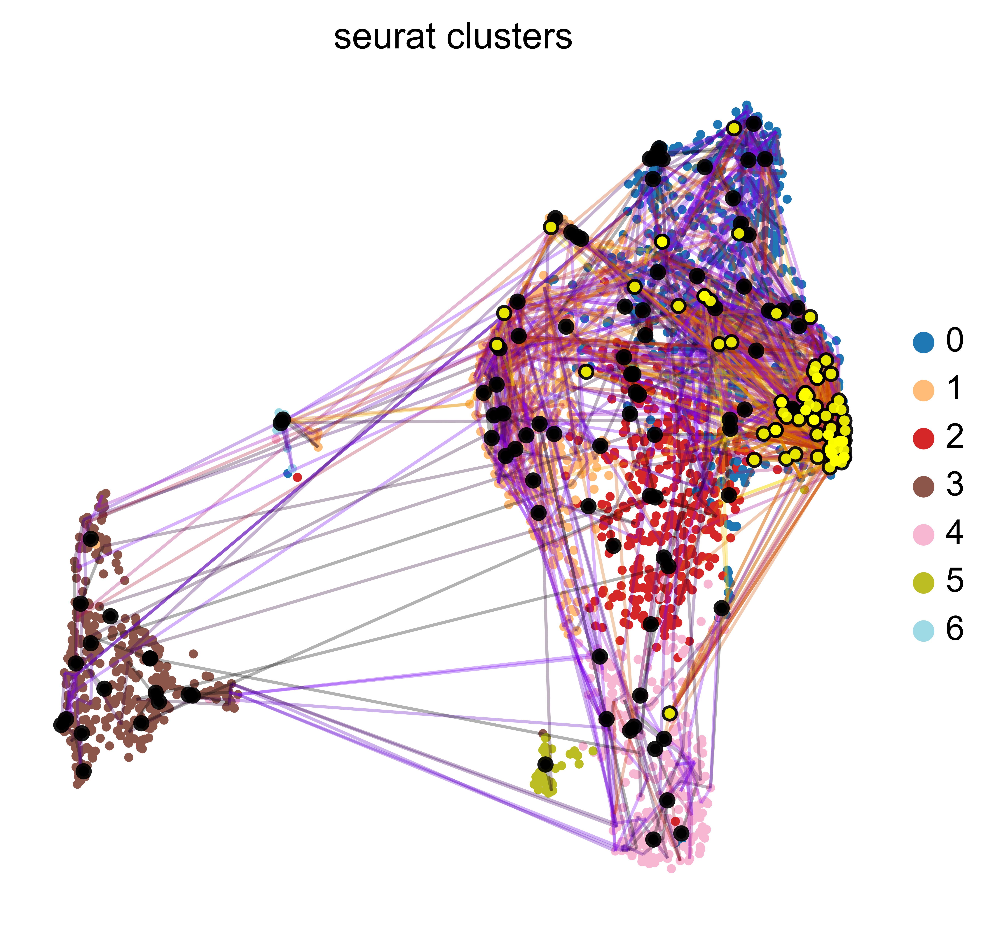

In [297]:
vk.plot_random_walks(
    max_iter=30,
    color="seurat_clusters",
    palette="tab20",
    seed=0,
    legend_loc="right margin",
    figsize=(5, 5),
    dpi=600,
    rasterized=False,  # Add this parameter to disable rasterization
    save="random_walks_with_clusters_vector.svg"
)

In [193]:
adata_Mets_subset.layers['velocity']

array([[ 2.28203855e-02,  0.00000000e+00,  0.00000000e+00, ...,
         0.00000000e+00,  0.00000000e+00, -3.23024912e-01],
       [ 1.60412786e-03,  0.00000000e+00,  0.00000000e+00, ...,
         0.00000000e+00,  0.00000000e+00,  3.75709766e-01],
       [ 2.67636257e-02,  0.00000000e+00,  0.00000000e+00, ...,
         0.00000000e+00,  0.00000000e+00, -1.19013110e-01],
       ...,
       [ 8.77592965e-05,  0.00000000e+00,  0.00000000e+00, ...,
         0.00000000e+00,  0.00000000e+00, -8.33201296e-01],
       [ 5.22477215e-03,  0.00000000e+00,  0.00000000e+00, ...,
         0.00000000e+00,  0.00000000e+00, -6.39867852e-01],
       [ 5.06859325e-04,  0.00000000e+00,  0.00000000e+00, ...,
         0.00000000e+00,  0.00000000e+00, -2.24802559e-01]])

In [194]:
# 1) Clean *all* arrays that could sneak in non-finite values
for arr in [
    adata_Mets_subset.obsm.get("X_umap"),
    adata_Mets_subset.obsm.get("T_fwd_umap"),
    adata_Mets_subset.obsm.get("T_bwd_umap"),
    adata_Mets_subset.layers.get("velocity"),
    adata_Mets_subset.layers.get("velocity_neg"),
]:
    if arr is not None:
        _clean = np.nan_to_num(arr, nan=0.0, posinf=0.0, neginf=0.0)
        # Write back to the same slot
        # need to check whether it was obsm or layers
        if arr is adata_Mets_subset.obsm.get("X_umap"):
            adata_Mets_subset.obsm["X_umap"] = _clean
        elif arr is adata_Mets_subset.obsm.get("T_fwd_umap"):
            adata_Mets_subset.obsm["T_fwd_umap"] = _clean
        elif arr is adata_Mets_subset.obsm.get("T_bwd_umap"):
            adata_Mets_subset.obsm["T_bwd_umap"] = _clean
        elif arr is adata_Mets_subset.layers.get("velocity"):
            adata_Mets_subset.layers["velocity"] = _clean
        elif arr is adata_Mets_subset.layers.get("velocity_neg"):
            adata_Mets_subset.layers["velocity_neg"] = _clean


Using precomputed projection `adata.obsm['T_fwd_umap']`


/opt/anaconda3/envs/ISS/lib/python3.12/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/opt/anaconda3/envs/ISS/lib/python3.12/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/opt/anaconda3/envs/ISS/lib/python3.12/site-packages/scvelo/plotting/utils.py:68: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/opt/anaconda3/envs/ISS/lib/python3.12/site-packages/scvelo/plotting/utils.py:68: Deprecati

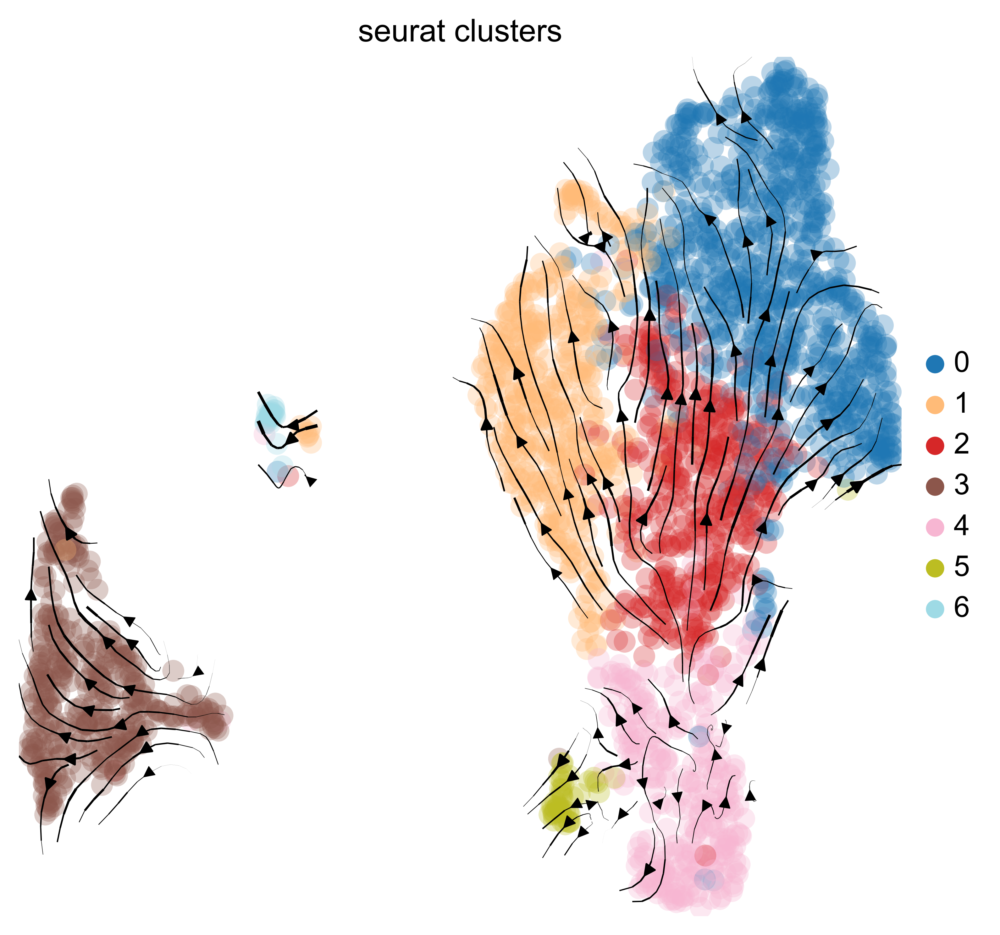

In [195]:
# 2) Create your own figure and axis
fig, ax = plt.subplots(figsize=(6, 6), dpi=300)

# 3) Draw the velocity field + clusters on YOUR axis
vk.plot_projection(
    basis="X_umap",
    stream=True,
    color="seurat_clusters",
    palette="tab20",
    legend_loc="right margin",
    ax=ax,         # <-- direct your plot here
    show=False     # disable scVelo’s internal save/show
)


In [200]:
# Rasterize all the streamline collections
for coll in ax.collections:
    coll.set_rasterized(True)

# Now save as PDF
fig.savefig(
    "./figures/velocity_with_clusters.pdf",
    format="pdf",
    bbox_inches="tight",
    pad_inches=0.1
)
plt.close(fig)

## Write processed data

In [202]:
# 1) Push the combined kernel back into the AnnData
combined_kernel.write_to_adata()  

# 2) Save your fully‐annotated object
adata_Mets_subset.write_h5ad(
    "./processed_h5ads/adata_Mets_subset_velocity.h5ad",
    compression="gzip"
)


## Identify initial and terminal states
### Initialize an estimator

In [270]:
import warnings

# Ignore the specific DeprecationWarning from scvelo
warnings.filterwarnings(
    'ignore',
    category=DeprecationWarning,
    message='is_categorical_dtype is deprecated'
)

In [271]:
g = cr.estimators.GPCCA(vk)
print(g)

GPCCA[kernel=VelocityKernel[n=2402], initial_states=None, terminal_states=None]


Computing Schur decomposition
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:00)
Calculating minChi criterion in interval `[3, 5]`
Computing `3` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:00)
saving figure to file ./figures/estimator_macrostates_plot.pdf


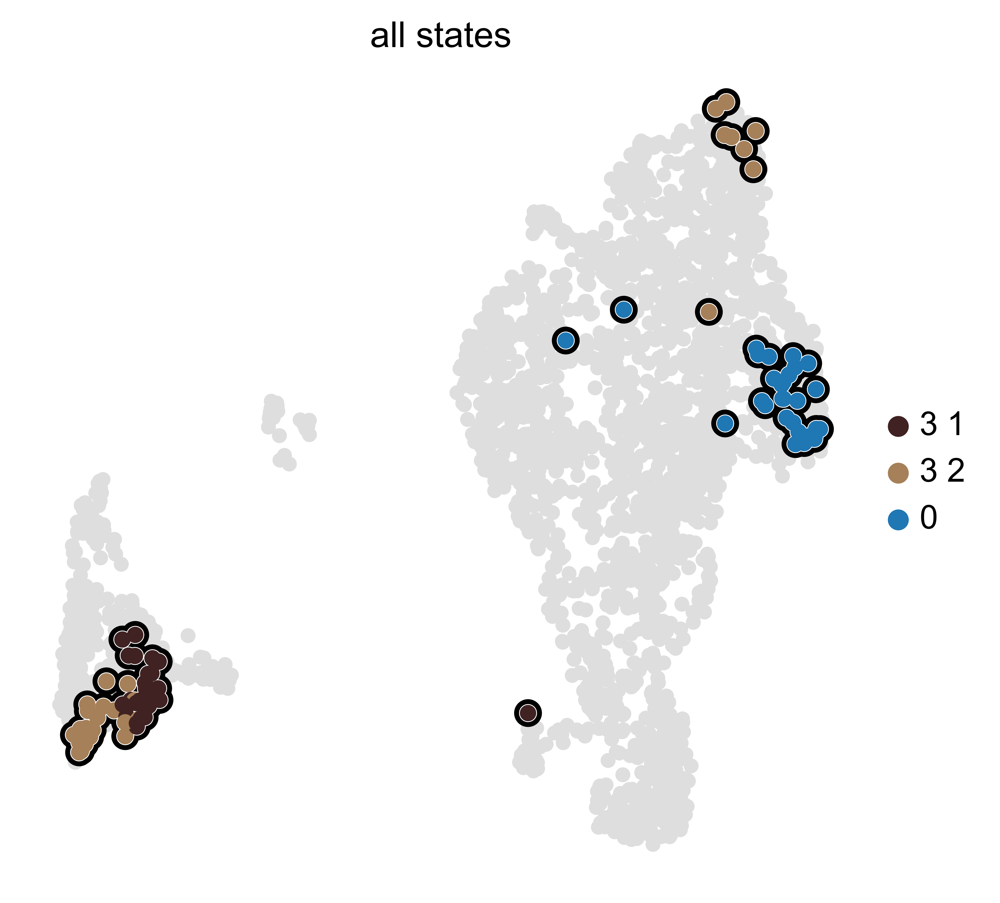

In [300]:
g.fit(cluster_key="seurat_clusters", n_states=[1, 5])
g.plot_macrostates(which="all", discrete=True, legend_loc="right", 
                s=100, 
                figsize=(5, 5),
                dpi=600,
                rasterized=False, 
                save="./figures/estimator_macrostates_plot.pdf",  # Specify the output file name and format
                  )

Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`
saving figure to file ./figures/estimator_terminal_plot.pdf


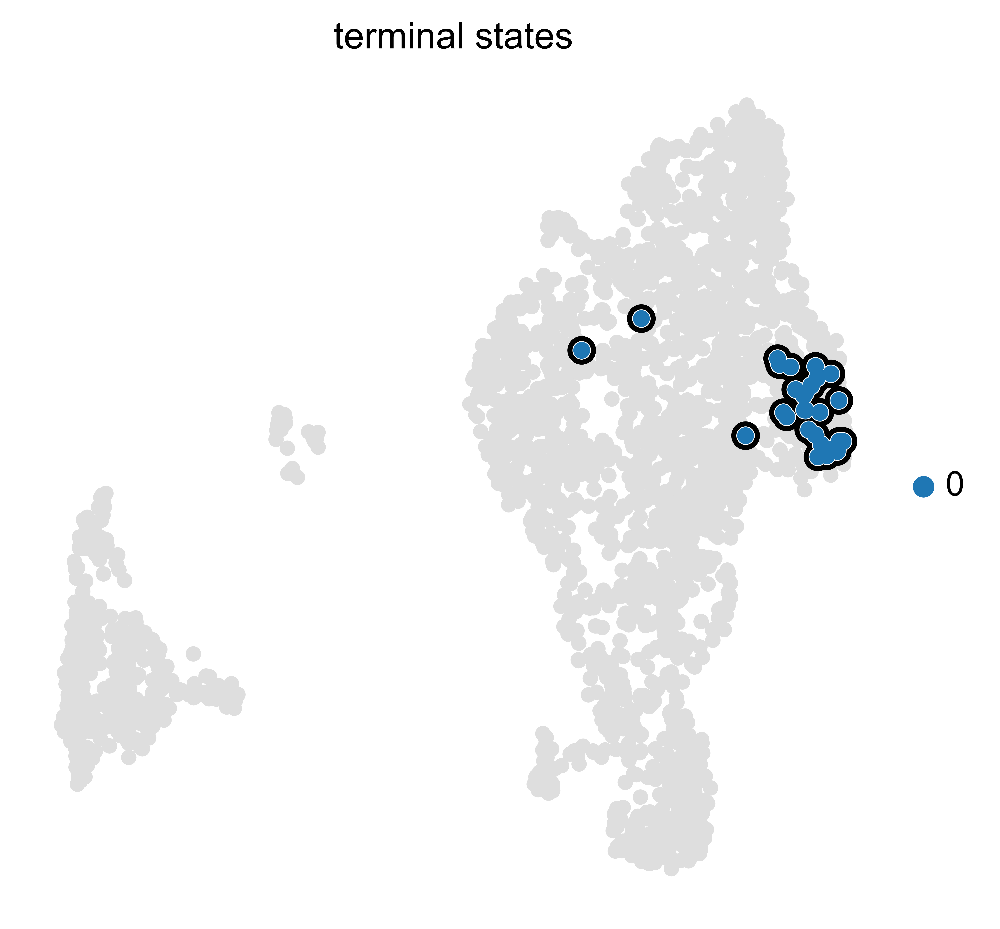

In [301]:
g.predict_terminal_states()
g.plot_macrostates(which="terminal", legend_loc="right", 
                s=100,
                figsize=(5, 5),
                dpi=600,
                rasterized=False, 
                save="./figures/estimator_terminal_plot.pdf"  # Specify the output file name and format
                  )

saving figure to file ./figures/estimator_terminal_plot_gradient.pdf


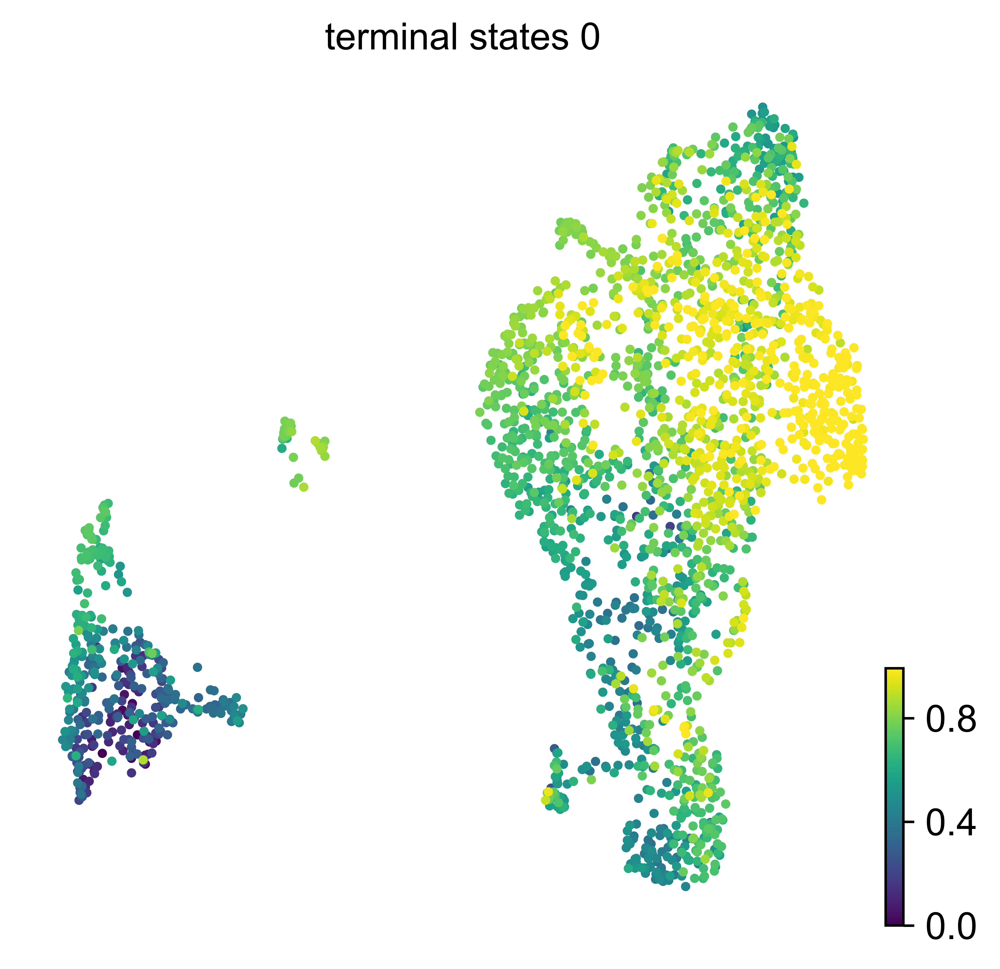

In [302]:
g.plot_macrostates(which="terminal", discrete=False,
                figsize=(5, 5),
                dpi=600,
                rasterized=False, 
                  save="./figures/estimator_terminal_plot_gradient.pdf",  # Specify the output file name and format
                  )

Adding `adata.obs['init_states_fwd']`
       `adata.obs['init_states_fwd_probs']`
       `.initial_states`
       `.initial_states_probabilities`
       `.initial_states_memberships
    Finish`
saving figure to file ./figures/estimator_initial_plot.pdf


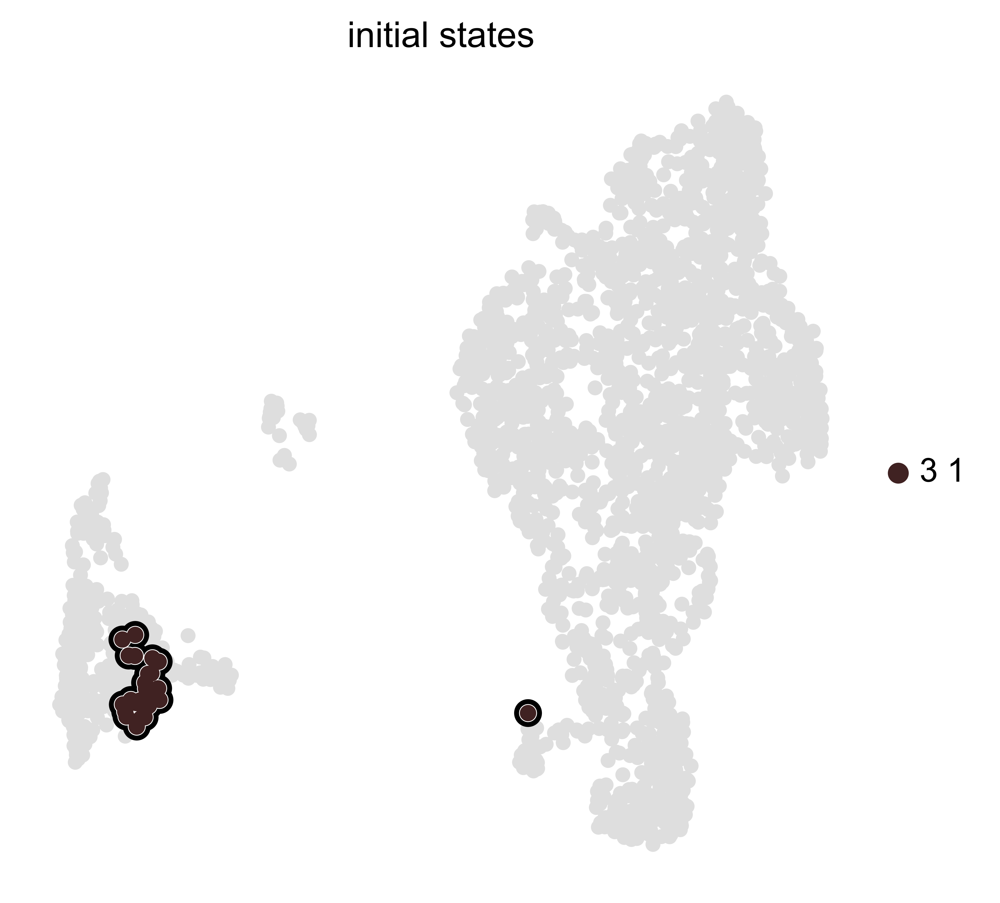

In [303]:
g.predict_initial_states()
g.plot_macrostates(which="initial", legend_loc="right", 
                s=100,
                figsize=(5, 5),
                dpi=600,
                rasterized=False, 
                save="./figures/estimator_initial_plot.pdf",  # Specify the output file name and format
                  )

In [304]:
g

GPCCA[kernel=VelocityKernel[n=2402], initial_states=['3_1'], terminal_states=['0']]

## Advanced usage

In [305]:
g2 = cr.estimators.GPCCA(vk)
print(g2)

GPCCA[kernel=VelocityKernel[n=2402], initial_states=None, terminal_states=None]


Computing Schur decomposition
When computing macrostates, choose a number of states NOT in `[6, 9, 12, 15, 17, 20]`
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:00)


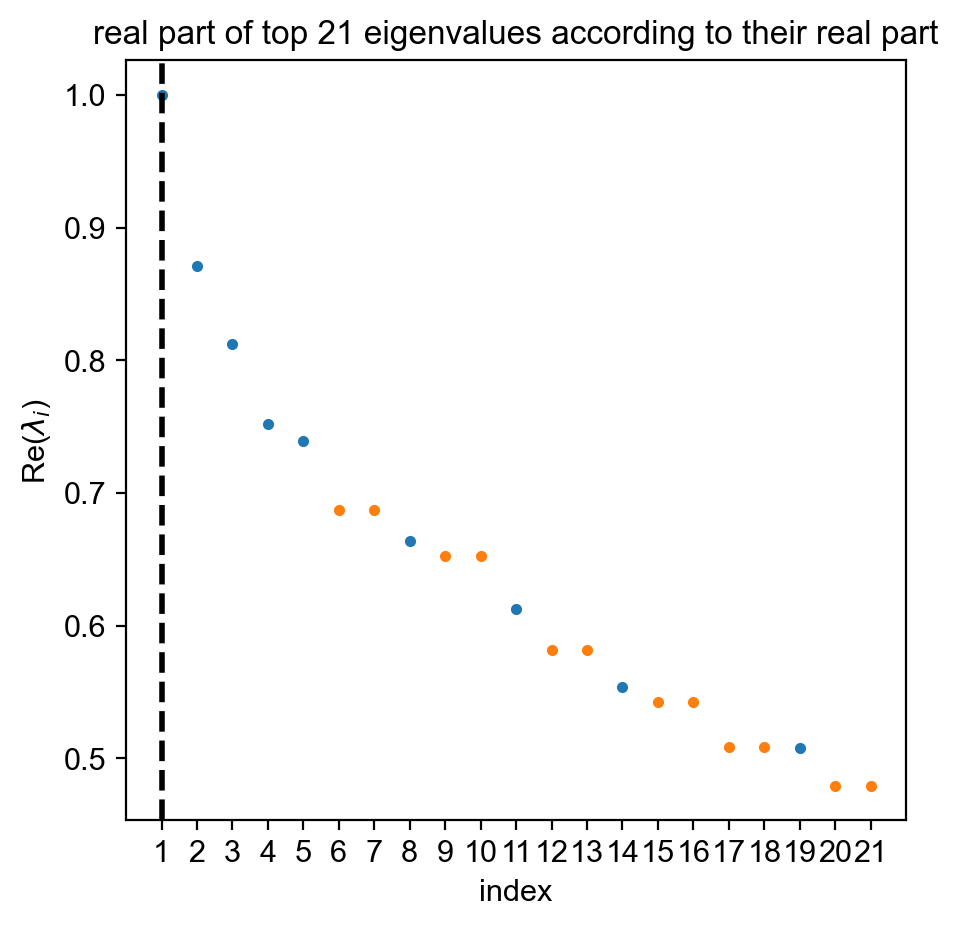

In [306]:
g2.compute_schur()
g2.plot_spectrum(real_only=True)

Computing `10` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:00)
saving figure to file ./figures/estimator_macrostates10_plot.pdf


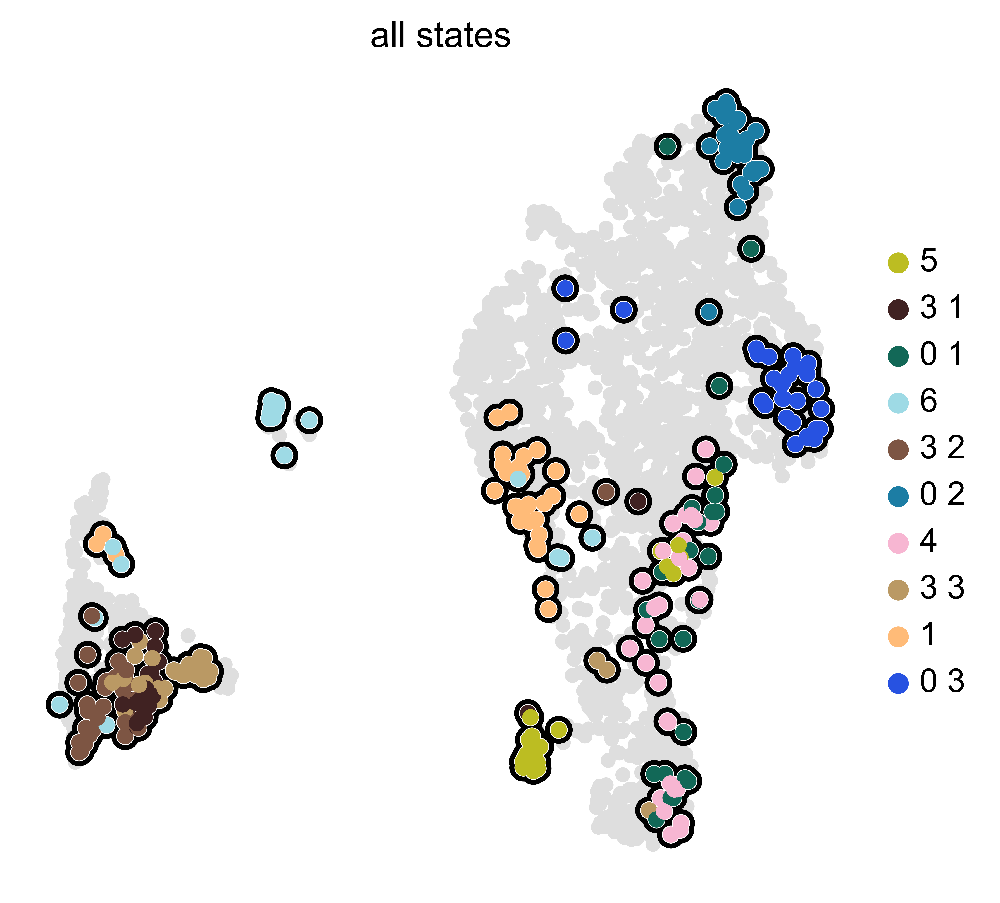

In [307]:
g2.compute_macrostates(n_states=10, cluster_key="seurat_clusters")
g2.plot_macrostates(which="all", legend_loc="right",
                s=100,
                figsize=(5, 5),
                dpi=600,
                rasterized=False,
                save="./figures/estimator_macrostates10_plot.pdf"
                   )

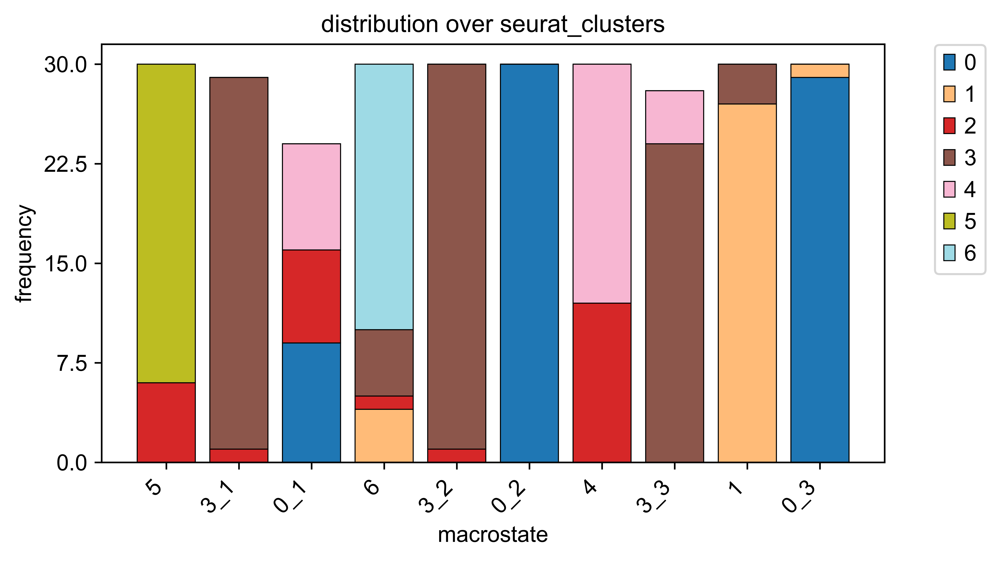

In [309]:
g2.plot_macrostate_composition(key="seurat_clusters", 
                figsize=(7, 4),
                dpi=600,
                save="./figures/estimator_macrostates10_composition_plot.pdf"
                              )

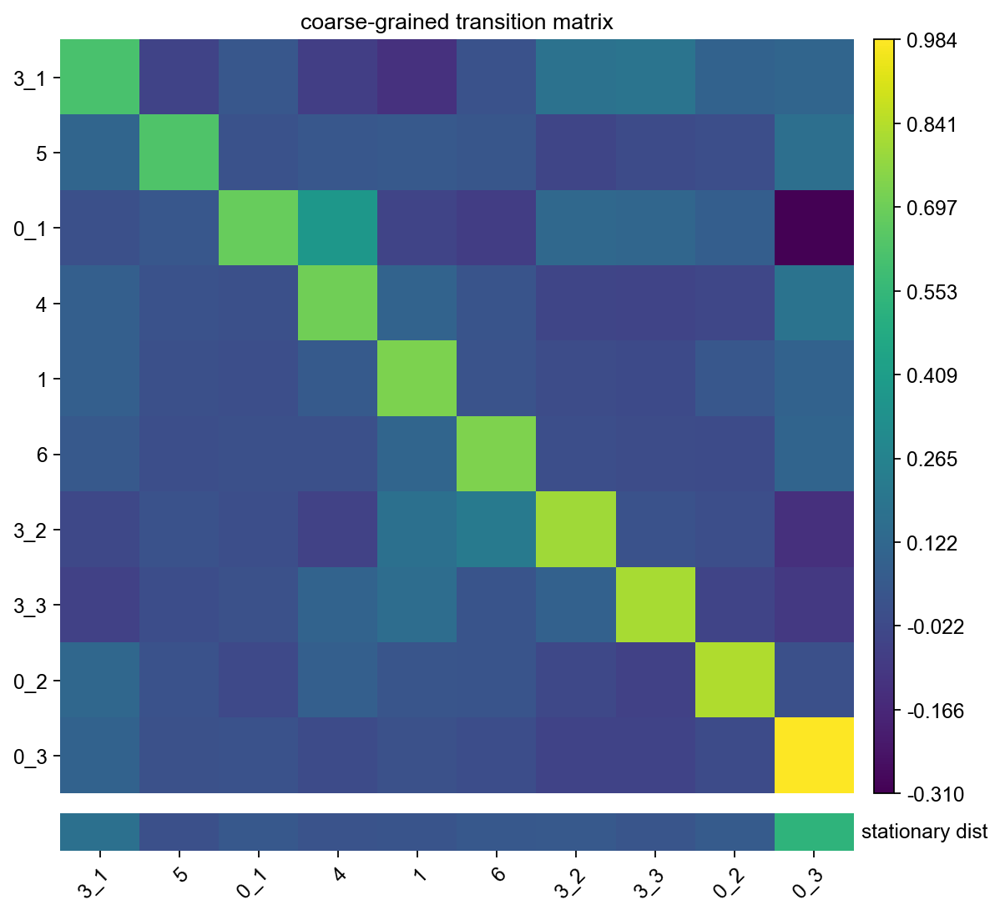

In [281]:
g2.plot_coarse_T(annotate=False)

Adding `adata.obs['term_states_fwd']`
       `adata.obs['term_states_fwd_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


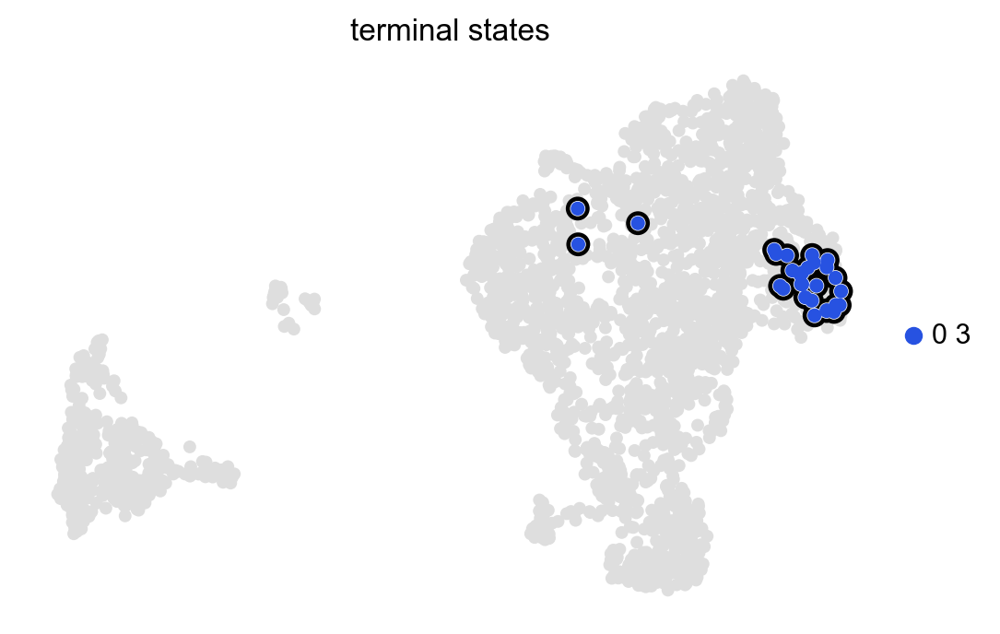

In [282]:
g2.predict_terminal_states()
g2.plot_macrostates(which="terminal", legend_loc="right", s=100)

Adding `adata.obs['init_states_fwd']`
       `adata.obs['init_states_fwd_probs']`
       `.initial_states`
       `.initial_states_probabilities`
       `.initial_states_memberships
    Finish`


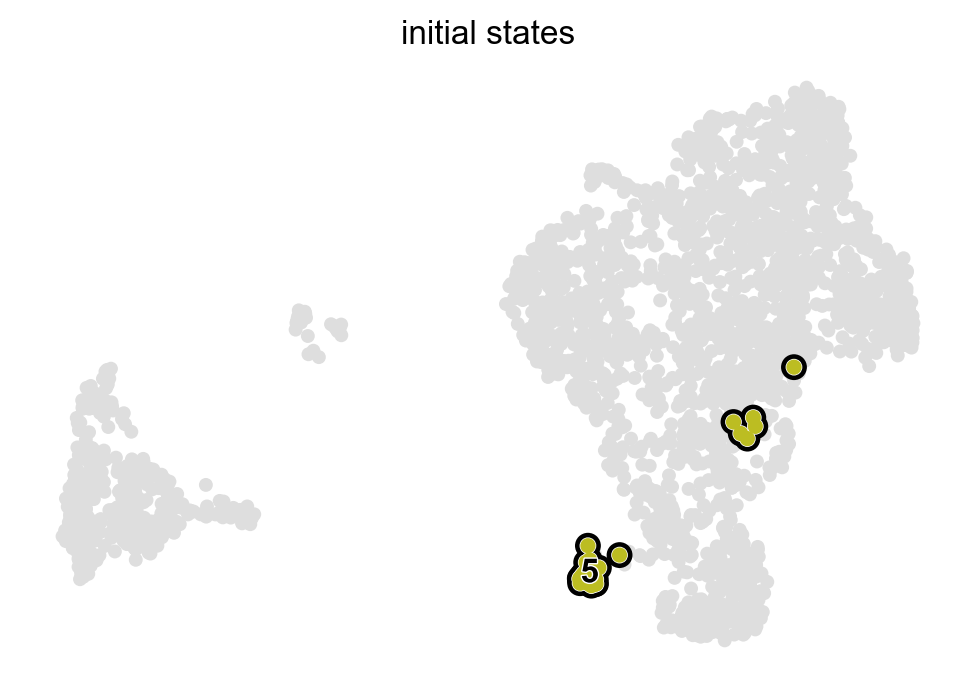

In [283]:
g2.predict_initial_states()
g2.plot_macrostates(which="initial", s=100)